# Group - 3

## Company Bankruptcy Prediction

#### Context: The data were collected from the Taiwan Economic Journal for the years 1999 to 2009. Company bankruptcy was defined based on the business regulations of the Taiwan Stock Exchange.

## Importing libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

## Accessing the Dataset

In [3]:
bank=pd.read_csv('bank.csv')
bank

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,...,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,...,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,0.264577,0.570175,1,0.020794
2,1,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,...,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,1,0.016474
3,1,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,...,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,1,0.023982
4,1,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,...,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,1,0.035490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6814,0,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,...,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,1,0.029890
6815,0,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,...,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,1,0.038284
6816,0,0.472725,0.533744,0.520638,0.610444,0.610213,0.998984,0.797401,0.809317,0.303512,...,0.797778,0.002840,0.624156,0.610441,0.840138,0.275789,0.026791,0.565158,1,0.097649
6817,0,0.506264,0.559911,0.554045,0.607850,0.607850,0.999074,0.797500,0.809399,0.303498,...,0.811808,0.002837,0.623957,0.607846,0.841084,0.277547,0.026822,0.565302,1,0.044009


In [4]:
bank.shape

(6819, 96)

## Understanding the Dataset

In [5]:
bank.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6819 entries, 0 to 6818
Data columns (total 96 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Bankrupt?                                                 6819 non-null   int64  
 1    ROA(C) before interest and depreciation before interest  6819 non-null   float64
 2    ROA(A) before interest and % after tax                   6819 non-null   float64
 3    ROA(B) before interest and depreciation after tax        6819 non-null   float64
 4    Operating Gross Margin                                   6819 non-null   float64
 5    Realized Sales Gross Margin                              6819 non-null   float64
 6    Operating Profit Rate                                    6819 non-null   float64
 7    Pre-tax net Interest Rate                                6819 non-null   float64
 8    After-tax net Int

In [6]:
bank[' Liability-Assets Flag'].value_counts()

0    6811
1       8
Name:  Liability-Assets Flag, dtype: int64

In [7]:
bank[' Net Income Flag'].value_counts()

1    6819
Name:  Net Income Flag, dtype: int64

In [8]:
bank['Bankrupt?'].value_counts()

0    6599
1     220
Name: Bankrupt?, dtype: int64

## Dropping unwanted columns

In [9]:
bank_1=bank.drop(['Bankrupt?',' Net Income Flag',' Liability-Assets Flag'],axis=1)
bank_1

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Current Liability to Current Assets,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Equity to Liability
0,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,...,0.118250,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,0.016469
1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,...,0.047775,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,0.264577,0.570175,0.020794
2,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,0.780284,...,0.025346,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,0.016474
3,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,0.781241,...,0.067250,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,0.023982
4,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,0.781550,...,0.047725,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,0.035490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6814,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,0.781588,...,0.027951,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,0.029890
6815,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,0.781586,...,0.031470,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,0.038284
6816,0.472725,0.533744,0.520638,0.610444,0.610213,0.998984,0.797401,0.809317,0.303512,0.781546,...,0.007542,0.797778,0.002840,0.624156,0.610441,0.840138,0.275789,0.026791,0.565158,0.097649
6817,0.506264,0.559911,0.554045,0.607850,0.607850,0.999074,0.797500,0.809399,0.303498,0.781663,...,0.022916,0.811808,0.002837,0.623957,0.607846,0.841084,0.277547,0.026822,0.565302,0.044009


In [10]:
y=bank['Bankrupt?']
y

0       1
1       1
2       1
3       1
4       1
       ..
6814    0
6815    0
6816    0
6817    0
6818    0
Name: Bankrupt?, Length: 6819, dtype: int64

## Detecting and Treating Outliers

In [11]:
from scipy.stats import zscore

z_score=zscore(bank_1)
z_score

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Current Liability to Current Assets,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Equity to Liability
0,-2.217909,-2.045798,-2.400361,-0.383334,-0.382638,0.016456,-0.023516,-0.020165,-0.087479,-0.031281,...,2.812493,-2.254317,-0.049491,-0.084274,-0.383465,-0.861611,0.680171,-0.060031,-0.098978,-0.622067
1,-0.673828,-0.311068,-0.598450,0.135068,0.136307,0.014671,0.014799,0.015966,-0.005957,0.009823,...,0.527485,-0.309033,-0.049491,-0.021388,0.135253,-0.029804,0.240685,15.129816,0.364559,-0.535573
2,-1.303672,-0.908420,-1.319910,-0.383759,-0.388177,0.007858,-0.061111,-0.051183,-0.142238,-0.086566,...,-0.199721,-0.820510,-0.049491,-0.005984,-0.383698,-0.249820,0.679247,-0.062961,-0.125015,-0.621960
3,-1.735886,-1.636209,-1.556340,-1.441418,-1.441832,-0.004257,-0.017313,-0.008676,-0.024491,-0.011077,...,1.158899,-1.691222,-0.049491,-0.080226,-1.441526,-0.392864,0.093765,-0.053903,-0.052562,-0.471826
4,-0.661778,-0.307745,-0.508050,-0.541238,-0.540708,0.016758,0.013703,0.016186,-0.013254,0.013300,...,0.525867,-0.316008,-0.049491,-0.032052,-0.541255,-0.029564,-0.128014,-0.178037,0.776395,-0.241715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6814,-0.189395,-0.291959,-0.168181,-0.206277,-0.204969,0.018215,0.017036,0.018197,-0.010092,0.016277,...,-0.115286,-0.194231,-0.049491,-0.024011,-0.206217,-0.002968,-0.052524,-0.030437,0.063215,-0.353693
6815,-0.494676,-0.310237,-0.477627,-0.569328,-0.568828,0.018223,0.017455,0.017919,-0.009248,0.016145,...,-0.001180,-0.198659,-0.049491,0.001317,-0.569333,-0.006633,-0.154404,-0.033992,0.049970,-0.185856
6816,-0.534845,-0.379194,-0.534996,0.147411,0.135029,0.017628,0.016412,0.017153,-0.009919,0.013012,...,-0.776979,-0.247517,-0.049491,0.019653,0.147305,-0.018166,-0.316446,-0.047870,-0.015101,1.001206
6817,0.017875,0.019594,0.007403,-0.005811,-0.004720,0.024494,0.024099,0.023223,-0.011175,0.022233,...,-0.278510,0.100366,-0.049491,0.003493,-0.005931,0.046934,-0.194852,-0.045898,-0.004270,-0.071364


In [12]:
z_score[z_score>3].count()

 ROA(C) before interest and depreciation before interest     37
 ROA(A) before interest and % after tax                      34
 ROA(B) before interest and depreciation after tax           36
 Operating Gross Margin                                      36
 Realized Sales Gross Margin                                 36
                                                           ... 
 Net Income to Stockholder's Equity                           6
 Liability to Equity                                         22
 Degree of Financial Leverage (DFL)                          12
 Interest Coverage Ratio (Interest expense to EBIT)          19
 Equity to Liability                                        106
Length: 93, dtype: int64

In [13]:
z_score[z_score<-3].count()

 ROA(C) before interest and depreciation before interest    51
 ROA(A) before interest and % after tax                     76
 ROA(B) before interest and depreciation after tax          65
 Operating Gross Margin                                     27
 Realized Sales Gross Margin                                27
                                                            ..
 Net Income to Stockholder's Equity                         21
 Liability to Equity                                         6
 Degree of Financial Leverage (DFL)                          0
 Interest Coverage Ratio (Interest expense to EBIT)         17
 Equity to Liability                                         0
Length: 93, dtype: int64

In [14]:
# removing outliers
filter_entry= (z_score >=-3) & (z_score <=3)

In [15]:
x=bank_1[filter_entry]
x

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Current Liability to Current Assets,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Equity to Liability
0,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,...,0.118250,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,0.016469
1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,...,0.047775,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,NaN,0.570175,0.020794
2,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,0.780284,...,0.025346,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,0.016474
3,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,0.781241,...,0.067250,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,0.023982
4,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,0.781550,...,0.047725,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,0.035490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6814,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,0.781588,...,0.027951,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,0.029890
6815,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,0.781586,...,0.031470,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,0.038284
6816,0.472725,0.533744,0.520638,0.610444,0.610213,0.998984,0.797401,0.809317,0.303512,0.781546,...,0.007542,0.797778,0.002840,0.624156,0.610441,0.840138,0.275789,0.026791,0.565158,0.097649
6817,0.506264,0.559911,0.554045,0.607850,0.607850,0.999074,0.797500,0.809399,0.303498,0.781663,...,0.022916,0.811808,0.002837,0.623957,0.607846,0.841084,0.277547,0.026822,0.565302,0.044009


In [16]:
x['Bankrupt?']=y

In [17]:
x

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Equity to Liability,Bankrupt?
0,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,...,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,0.016469,1
1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,...,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,NaN,0.570175,0.020794,1
2,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,0.780284,...,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,0.016474,1
3,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,0.781241,...,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,0.023982,1
4,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,0.781550,...,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,0.035490,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6814,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,0.781588,...,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,0.029890,0
6815,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,0.781586,...,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,0.038284,0
6816,0.472725,0.533744,0.520638,0.610444,0.610213,0.998984,0.797401,0.809317,0.303512,0.781546,...,0.797778,0.002840,0.624156,0.610441,0.840138,0.275789,0.026791,0.565158,0.097649,0
6817,0.506264,0.559911,0.554045,0.607850,0.607850,0.999074,0.797500,0.809399,0.303498,0.781663,...,0.811808,0.002837,0.623957,0.607846,0.841084,0.277547,0.026822,0.565302,0.044009,0


In [18]:
x.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6819 entries, 0 to 6818
Data columns (total 94 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0    ROA(C) before interest and depreciation before interest  6731 non-null   float64
 1    ROA(A) before interest and % after tax                   6709 non-null   float64
 2    ROA(B) before interest and depreciation after tax        6718 non-null   float64
 3    Operating Gross Margin                                   6756 non-null   float64
 4    Realized Sales Gross Margin                              6756 non-null   float64
 5    Operating Profit Rate                                    6817 non-null   float64
 6    Pre-tax net Interest Rate                                6812 non-null   float64
 7    After-tax net Interest Rate                              6812 non-null   float64
 8    Non-industry inco

In [19]:
x=x.dropna()
x

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Equity to Liability,Bankrupt?
0,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,...,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,0.016469,1
4,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,0.781550,...,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,0.035490,1
6,0.390923,0.445704,0.436158,0.619950,0.619950,0.998993,0.797012,0.808960,0.302814,0.781180,...,0.736619,0.018372,0.623655,0.619949,0.829980,0.292504,0.026622,0.564200,0.015663,0
7,0.508361,0.570922,0.559077,0.601738,0.601717,0.999009,0.797449,0.809362,0.303545,0.781621,...,0.815350,0.010005,0.623843,0.601739,0.841459,0.278607,0.027031,0.566089,0.034889,0
8,0.488519,0.545137,0.543284,0.603612,0.603612,0.998961,0.797414,0.809338,0.303584,0.781598,...,0.803647,0.000824,0.623977,0.603613,0.840487,0.276423,0.026891,0.565592,0.065826,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6812,0.491639,0.549498,0.537877,0.613219,0.613168,0.998999,0.797436,0.809344,0.303543,0.781604,...,0.806743,0.000548,0.623743,0.613219,0.840676,0.276560,0.026811,0.565253,0.061753,0
6813,0.477600,0.531127,0.526099,0.595829,0.595858,0.998905,0.797375,0.809294,0.303634,0.781553,...,0.794028,0.003475,0.623398,0.595827,0.839864,0.281325,0.022309,0.571752,0.024803,0
6814,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,0.781588,...,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,0.029890,0
6815,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,0.781586,...,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,0.038284,0


In [20]:
y=x['Bankrupt?']
y

0       1
4       1
6       0
7       0
8       0
       ..
6812    0
6813    0
6814    0
6815    0
6816    0
Name: Bankrupt?, Length: 4909, dtype: int64

In [21]:
y.value_counts()

0    4790
1     119
Name: Bankrupt?, dtype: int64

In [22]:
x=x.drop(['Bankrupt?'],axis=1)
x

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Current Liability to Current Assets,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Equity to Liability
0,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,...,0.118250,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,0.016469
4,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,0.781550,...,0.047725,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,0.035490
6,0.390923,0.445704,0.436158,0.619950,0.619950,0.998993,0.797012,0.808960,0.302814,0.781180,...,0.060765,0.736619,0.018372,0.623655,0.619949,0.829980,0.292504,0.026622,0.564200,0.015663
7,0.508361,0.570922,0.559077,0.601738,0.601717,0.999009,0.797449,0.809362,0.303545,0.781621,...,0.030201,0.815350,0.010005,0.623843,0.601739,0.841459,0.278607,0.027031,0.566089,0.034889
8,0.488519,0.545137,0.543284,0.603612,0.603612,0.998961,0.797414,0.809338,0.303584,0.781598,...,0.021710,0.803647,0.000824,0.623977,0.603613,0.840487,0.276423,0.026891,0.565592,0.065826
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6812,0.491639,0.549498,0.537877,0.613219,0.613168,0.998999,0.797436,0.809344,0.303543,0.781604,...,0.022721,0.806743,0.000548,0.623743,0.613219,0.840676,0.276560,0.026811,0.565253,0.061753
6813,0.477600,0.531127,0.526099,0.595829,0.595858,0.998905,0.797375,0.809294,0.303634,0.781553,...,0.048055,0.794028,0.003475,0.623398,0.595827,0.839864,0.281325,0.022309,0.571752,0.024803
6814,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,0.781588,...,0.027951,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,0.029890
6815,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,0.781586,...,0.031470,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,0.038284


In [23]:
x.shape

(4909, 93)

In [24]:
from sklearn.preprocessing import StandardScaler

sc=StandardScaler()

x_scaled=sc.fit_transform(x)
x_scaled

array([[-2.85284146e+00, -2.80904766e+00, -3.18207070e+00, ...,
        -2.24001963e-01, -5.13182376e-01, -9.99716462e-01],
       [-8.74521323e-01, -4.68848059e-01, -7.08067248e-01, ...,
        -1.11848780e+00,  3.79744151e+00, -2.38660582e-01],
       [-2.42694601e+00, -2.37165854e+00, -2.53657968e+00, ...,
        -2.13518808e-01, -4.57277470e-01, -1.03195148e+00],
       ...,
       [-2.73978090e-01, -4.47593856e-01, -2.63723955e-01, ...,
         3.17384962e-04,  2.85509237e-01, -4.62720982e-01],
       [-6.62084261e-01, -4.72203986e-01, -6.68292273e-01, ...,
        -2.66279459e-02,  2.20286332e-01, -1.26891909e-01],
       [-7.13150863e-01, -5.65051293e-01, -7.43296512e-01, ...,
        -1.31820904e-01, -1.00146484e-01,  2.24832621e+00]])

## Converting to Data Frame

In [25]:
bank_2=pd.DataFrame(x_scaled,columns=x.columns)
bank_2

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Current Liability to Current Assets,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Equity to Liability
0,-2.852841,-2.809048,-3.182071,-0.586744,-0.586739,-0.364110,-1.497294,-1.692656,-1.576447,-1.653973,...,5.509508,-3.386842,0.063657,-0.407346,-0.586964,-5.537901,2.778007,-0.224002,-0.513182,-0.999716
1,-0.874521,-0.468848,-0.708067,-0.854509,-0.855147,-0.337196,-0.252871,-0.204078,-0.118064,-0.201696,...,1.098451,-0.550827,-0.151761,-0.137870,-0.854533,-0.418816,-0.336684,-1.118488,3.797442,-0.238661
2,-2.426946,-2.371659,-2.536580,1.265238,1.269690,-0.200249,-1.173068,-1.237889,-1.280771,-1.152330,...,1.914034,-2.669453,0.432739,-0.081289,1.265304,-4.652608,3.391515,-0.213519,-0.457277,-1.031951
3,0.033443,0.197863,0.072659,-0.558597,-0.560694,-0.091800,-0.037918,-0.030012,0.004460,-0.018133,...,0.002379,0.186906,0.095315,-0.002684,-0.558317,0.211062,-0.311764,-0.016013,0.246650,-0.262733
4,-0.382239,-0.331255,-0.262588,-0.370944,-0.370421,-0.421897,-0.129579,-0.100579,0.072955,-0.077998,...,-0.528676,-0.237680,-0.274896,0.053829,-0.370631,-0.201094,-0.893976,-0.083693,0.061413,0.975106
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4904,-0.316874,-0.241764,-0.377367,0.591134,0.588903,-0.163044,-0.071707,-0.083329,0.002333,-0.062130,...,-0.465440,-0.125386,-0.286030,-0.044543,0.591340,-0.120690,-0.857294,-0.122089,-0.065072,0.812143
4905,-0.611018,-0.618746,-0.627381,-1.150422,-1.148876,-0.805031,-0.228428,-0.233481,0.162296,-0.193041,...,1.119040,-0.586661,-0.168009,-0.189493,-1.150406,-0.464970,0.412405,-2.300175,2.357150,-0.666268
4906,-0.273978,-0.447594,-0.263724,-0.286501,-0.285051,-0.207374,-0.141441,-0.121749,-0.055951,-0.104685,...,-0.138376,-0.372651,-0.289356,-0.096377,-0.286397,-0.255186,-0.045749,0.000317,0.285509,-0.462721
4907,-0.662084,-0.472204,-0.668292,-0.902144,-0.902896,-0.206582,-0.127422,-0.133118,-0.039359,-0.109013,...,0.081742,-0.379130,-0.229119,0.034319,-0.902148,-0.277734,-0.438388,-0.026628,0.220286,-0.126892


## Dimensionality Reduction

## Principle Component Analysis

### Construction of covariance matrix

In [26]:
bank_cm=np.cov(x_scaled.T)
bank_cm

array([[ 1.00020375,  0.93332557,  0.98578917, ..., -0.04198324,
         0.05325812,  0.16915632],
       [ 0.93332557,  1.00020375,  0.94549148, ..., -0.02533613,
         0.07494755,  0.17656846],
       [ 0.98578917,  0.94549148,  1.00020375, ..., -0.03355825,
         0.06133207,  0.17355516],
       ...,
       [-0.04198324, -0.02533613, -0.03355825, ...,  1.00020375,
         0.18317641, -0.06962947],
       [ 0.05325812,  0.07494755,  0.06133207, ...,  0.18317641,
         1.00020375, -0.03669099],
       [ 0.16915632,  0.17656846,  0.17355516, ..., -0.06962947,
        -0.03669099,  1.00020375]])

In [27]:
bank_cm.shape

(93, 93)

### Finding Eigen Value and Eigen Vector

In [28]:
eig_val,eig_vec=np.linalg.eig(bank_cm)
eig_val

array([ 1.90497018e+01,  1.01373388e+01,  7.16877514e+00,  4.24167503e+00,
        3.76736614e+00,  3.29806629e+00,  2.83092743e+00,  2.52456844e+00,
        2.30699622e+00,  1.91359310e+00,  1.71402394e+00,  1.57676529e+00,
        1.52999068e+00,  1.41051202e+00,  1.31922096e+00,  1.24810207e+00,
        1.13920275e+00,  1.07961416e+00,  1.05274473e+00,  1.03054761e+00,
        1.00794050e+00,  9.90603918e-01,  9.77499308e-01,  9.67974216e-01,
        9.58003351e-01,  9.30733533e-01,  9.21261342e-01,  9.12025516e-01,
        9.06308196e-01,  8.85011792e-01,  8.25557213e-01,  8.20674098e-01,
        7.98265320e-01,  7.43148239e-01,  7.14435058e-01,  6.80139134e-01,
        5.96021919e-01,  5.81536348e-01,  5.67321409e-01,  5.36343981e-01,
        5.14978753e-01,  4.74099105e-01,  4.68705348e-01,  4.48917256e-01,
        4.13565017e-01,  3.78042018e-01,  3.37883648e-01,  3.13948840e-01,
        3.01670128e-01,  2.95328771e-01,  2.65053385e-01,  2.41528433e-01,
        2.13791202e-01,  

In [29]:
eig_vec

array([[-1.92751048e-01, -8.41598174e-02,  9.17859593e-02, ...,
        -3.43671100e-10,  5.74902665e-11, -6.48017454e-11],
       [-1.98383273e-01, -1.02364206e-01,  6.88974583e-02, ...,
        -1.94995107e-11,  3.17559273e-12, -3.57205684e-12],
       [-1.93154692e-01, -8.11689175e-02,  9.35857167e-02, ...,
         4.91518632e-10, -8.21910386e-11,  9.26423971e-11],
       ...,
       [ 1.71346933e-02, -1.38208958e-02,  2.49484638e-02, ...,
         3.12252379e-11, -5.23176188e-12,  5.89733207e-12],
       [-9.33497583e-03, -2.69555104e-02,  2.92898673e-02, ...,
         1.98390679e-11, -3.32175712e-12,  3.74499256e-12],
       [-1.11486177e-01,  1.92410210e-01, -9.40812281e-02, ...,
         1.28708781e-10, -2.14936892e-11,  2.42261272e-11]])

### Sorting the Eigen values

In [30]:
sorted_eig_val=[i for i in sorted(eig_val, reverse=True)]
sorted_eig_val

[19.04970184137898,
 10.137338842293035,
 7.168775144192326,
 4.241675026287185,
 3.767366144541072,
 3.2980662932714186,
 2.8309274265213262,
 2.5245684434574764,
 2.306996218700514,
 1.9135930954124094,
 1.714023936003324,
 1.5767652874474187,
 1.5299906825135832,
 1.4105120233797428,
 1.3192209606499363,
 1.248102070894853,
 1.1392027529378792,
 1.079614160945829,
 1.0527447330573085,
 1.0305476061068735,
 1.0079405034256799,
 0.9906039184810743,
 0.9774993075772079,
 0.9679742159924141,
 0.9580033507490191,
 0.9307335331833833,
 0.9212613423513509,
 0.9120255156881207,
 0.9063081956436918,
 0.8850117915351134,
 0.8255572128715064,
 0.8206740978600988,
 0.7982653202817731,
 0.7431482388194115,
 0.7144350582053057,
 0.6801391343730687,
 0.5960219186239628,
 0.5815363477215441,
 0.5673214090063466,
 0.5363439808470727,
 0.5149787531141825,
 0.47409910484946205,
 0.468705347874343,
 0.4489172561653514,
 0.4135650166651373,
 0.37804201763205764,
 0.3378836481338617,
 0.31394884031059656

In [31]:
tot=sum(sorted_eig_val)
tot

93.01894865525679

In [32]:
exp_var=[(i/tot) for i in sorted_eig_val]
exp_var

[0.20479377714728042,
 0.10898143860842424,
 0.07706790119463681,
 0.04560011790723969,
 0.040501061332175854,
 0.03545585432807442,
 0.030433878983229527,
 0.027140367419265655,
 0.02480135770240334,
 0.020572078303147605,
 0.018426610500144148,
 0.016951011705057695,
 0.016448161419067152,
 0.01516370636059678,
 0.01418228199438355,
 0.013417718528732466,
 0.012246996653982278,
 0.011606389628709447,
 0.011317529904137598,
 0.01107889974037708,
 0.010835862133437669,
 0.010649485215667316,
 0.010508604125380709,
 0.010406204649548152,
 0.010299012884993292,
 0.010005848772090853,
 0.00990401800568284,
 0.009804728271744225,
 0.009743264235361506,
 0.009514317290502925,
 0.008875150975218548,
 0.008822655058182277,
 0.008581749544818797,
 0.007989213483519778,
 0.007680532499384799,
 0.007311834246737984,
 0.0064075323064864565,
 0.006251805208816232,
 0.00609898754187097,
 0.005765964769553028,
 0.005536277936474822,
 0.005096801369004392,
 0.005038815796676444,
 0.004826083960904687

In [33]:
cum_exp_var=np.cumsum(exp_var)
cum_exp_var

array([0.20479378, 0.31377522, 0.39084312, 0.43644323, 0.4769443 ,
       0.51240015, 0.54283403, 0.5699744 , 0.59477575, 0.61534783,
       0.63377444, 0.65072546, 0.66717362, 0.68233732, 0.6965196 ,
       0.70993732, 0.72218432, 0.73379071, 0.74510824, 0.75618714,
       0.767023  , 0.77767249, 0.78818109, 0.7985873 , 0.80888631,
       0.81889216, 0.82879618, 0.8386009 , 0.84834417, 0.85785848,
       0.86673364, 0.87555629, 0.88413804, 0.89212725, 0.89980779,
       0.90711962, 0.91352715, 0.91977896, 0.92587795, 0.93164391,
       0.93718019, 0.94227699, 0.94731581, 0.95214189, 0.95658792,
       0.96065206, 0.96428448, 0.96765958, 0.97090269, 0.97407762,
       0.97692707, 0.97952363, 0.98182199, 0.98396186, 0.98592461,
       0.98766036, 0.98936278, 0.99057629, 0.99169748, 0.99271228,
       0.99370539, 0.99460981, 0.99540455, 0.9961455 , 0.99675348,
       0.99725542, 0.99771054, 0.99804557, 0.99836222, 0.99862775,
       0.99888762, 0.99910546, 0.99929181, 0.99944871, 0.99957

### Plotting

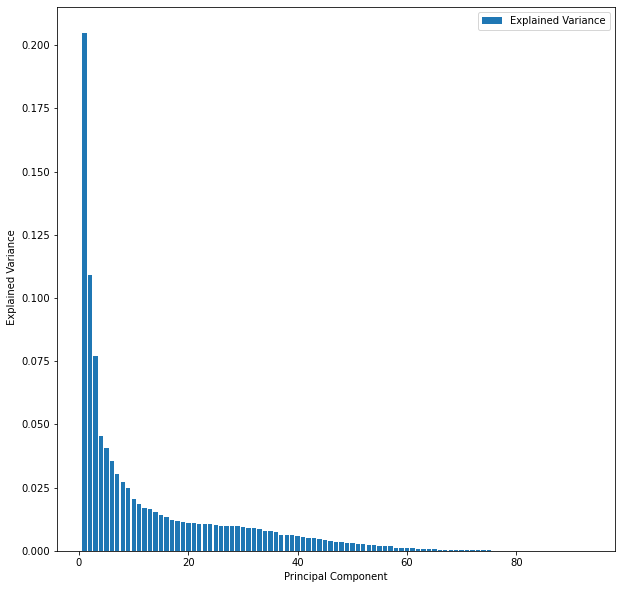

In [34]:
plt.figure(figsize=(10,10))
plt.bar(range(1,94), exp_var,label='Explained Variance')
plt.xlabel('Principal Component')
plt.ylabel(' Explained Variance')
plt.legend();

### Construction of Projection Matrix

In [35]:
eigen_pair=[(np.abs(eig_val[i]),eig_vec[:,i]) for i in range(len(eig_val))]
eigen_pair

[(19.04970184137898,
  array([-0.19275105, -0.19838327, -0.19315469, -0.13625797, -0.13573768,
         -0.15737866, -0.13168463, -0.13102609, -0.07127564, -0.12099738,
          0.00725084, -0.01957673, -0.12620125, -0.01082576, -0.07037264,
         -0.1402587 , -0.1403575 , -0.14029271, -0.19048782, -0.11357549,
         -0.02776349, -0.16726255, -0.18831775, -0.00828661, -0.02442416,
         -0.05164237, -0.05224379, -0.03739494, -0.00753308, -0.05798402,
         -0.08479649, -0.08037223, -0.11693637, -0.1272019 ,  0.00260832,
          0.137026  ,  0.13882244, -0.13882244, -0.02437048,  0.14566088,
          0.03005946, -0.16711556, -0.18856095,  0.06864869, -0.03913354,
          0.01035221, -0.01703641,  0.00749929,  0.0406185 ,  0.02116003,
          0.00215936, -0.11421088,  0.04231947, -0.12837931, -0.0756852 ,
         -0.04559963, -0.1049333 , -0.1236754 ,  0.00755853,  0.10649587,
         -0.1333669 ,  0.01302703,  0.00185181, -0.02495627, -0.09712304,
          0.12083

### Taking first 2 components

In [36]:
two_comp=np.hstack((eigen_pair[0][1][:,np.newaxis],
            eigen_pair[1][1][:,np.newaxis]))

In [37]:
two_comp

array([[-0.19275105, -0.08415982],
       [-0.19838327, -0.10236421],
       [-0.19315469, -0.08116892],
       [-0.13625797,  0.04177853],
       [-0.13573768,  0.04263118],
       [-0.15737866, -0.07246751],
       [-0.13168463, -0.05975717],
       [-0.13102609, -0.05945861],
       [-0.07127564, -0.03177998],
       [-0.12099738, -0.06053634],
       [ 0.00725084, -0.07603933],
       [-0.01957673,  0.00341116],
       [-0.12620125,  0.09666329],
       [-0.01082576,  0.00829784],
       [-0.07037264, -0.08968042],
       [-0.1402587 , -0.06869633],
       [-0.1403575 , -0.06845635],
       [-0.14029271, -0.06850762],
       [-0.19048782, -0.12516701],
       [-0.11357549,  0.01758401],
       [-0.02776349, -0.23927045],
       [-0.16726255, -0.14297082],
       [-0.18831775, -0.13045892],
       [-0.00828661, -0.00828177],
       [-0.02442416, -0.03080938],
       [-0.05164237, -0.04446155],
       [-0.05224379, -0.04477046],
       [-0.03739494, -0.03867817],
       [-0.00753308,

In [38]:
two_comp.shape

(93, 2)

### Transforming the dataset into 2 components

In [39]:
x_scaled.shape

(4909, 93)

In [40]:
two_comp.shape

(93, 2)

In [41]:
pca_x=x_scaled.dot(two_comp)
pca_x

array([[13.65572412, -0.21151853],
       [ 3.65037756, -0.0272901 ],
       [10.48090427, -0.03629094],
       ...,
       [ 1.83927026,  0.6498928 ],
       [ 1.72843855,  0.757978  ],
       [-4.27182413,  4.57383138]])

In [42]:
pca_x.shape

(4909, 2)

### Visualising the final data

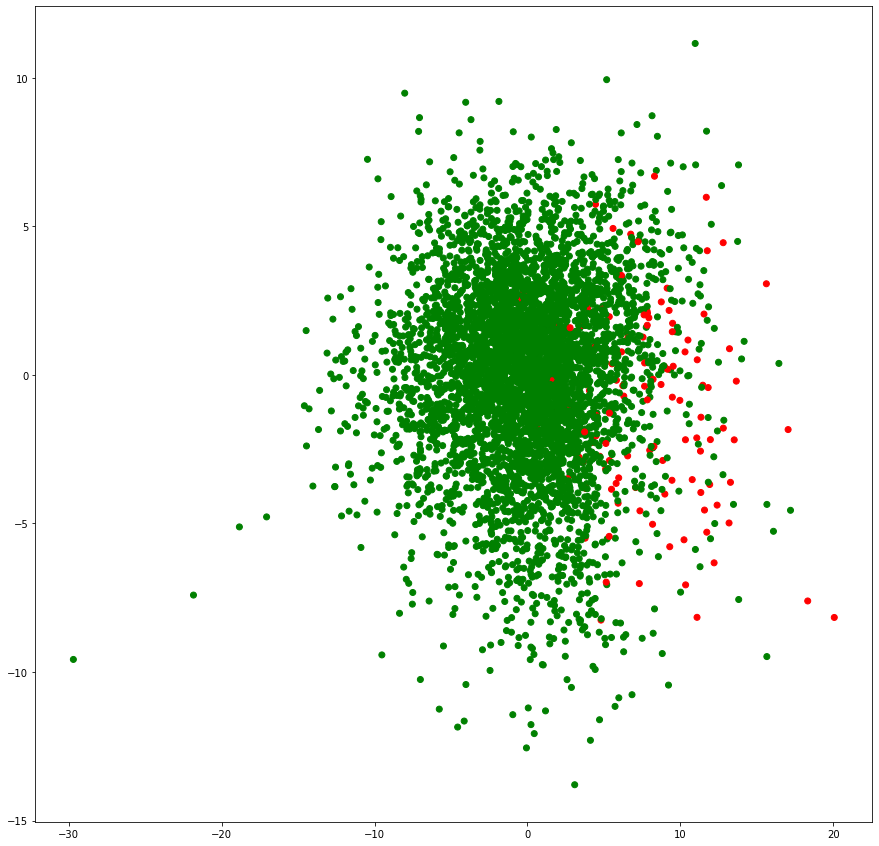

In [43]:
colours={0:'green',1:'red'}
plt.figure(figsize=(15,15))
plt.scatter(pca_x[:,0],pca_x[:,1],c=y.map(colours));

inference : the segregation between two clusters is much better when compared with other dimensionality reduction methods.

## Linear Discriminant Analysis

In [44]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
lda=LinearDiscriminantAnalysis(n_components=1)
type(lda)

sklearn.discriminant_analysis.LinearDiscriminantAnalysis

In [45]:
x_lda=lda.fit_transform(x_scaled,y)

In [46]:
x_lda.shape

(4909, 1)

inference: Since there is just 1 component, thus plotting is not possible. 
           

## Locally Linear Embedding

In [47]:
from sklearn.manifold import LocallyLinearEmbedding
lle=LocallyLinearEmbedding(n_neighbors=10,random_state=100)

In [48]:
x_lle=lle.fit_transform(x_scaled)
x_lle

array([[-0.00725573, -0.0023593 ],
       [-0.00500215, -0.00126882],
       [-0.00664575, -0.00281295],
       ...,
       [-0.00509193,  0.00332341],
       [-0.00738139, -0.00055384],
       [ 0.00883802, -0.03157392]])

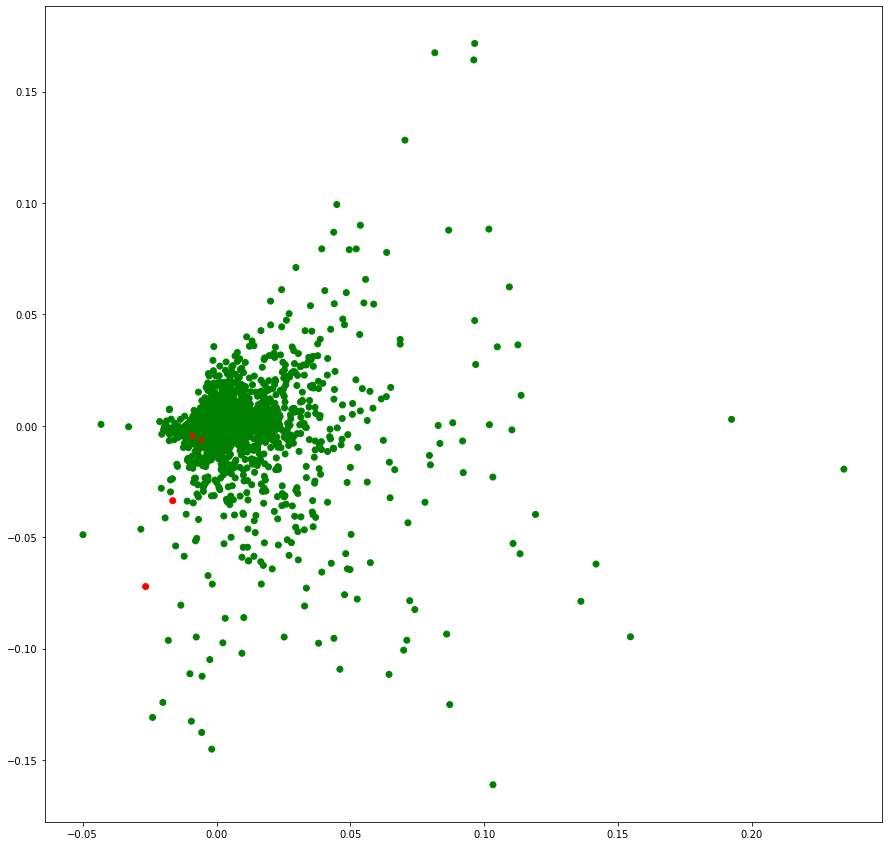

In [49]:
colours={0:'green',1:'red'}
plt.figure(figsize=(15,15))
plt.scatter(x_lle[:,0],x_lle[:,1],c=y.map(colours));

inference: The data is not in swiss roll format hence manifold learning is not posiible. thus, LLE is not a good option.

## t-Distributed Stochastic Neighbourhood Embedding

In [50]:
from sklearn.manifold import TSNE
tsne=TSNE(n_components=2,perplexity=30)

In [51]:
x_tsne=tsne.fit_transform(x_scaled)
x_tsne.shape

C:\Users\HP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\HP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


(4909, 2)

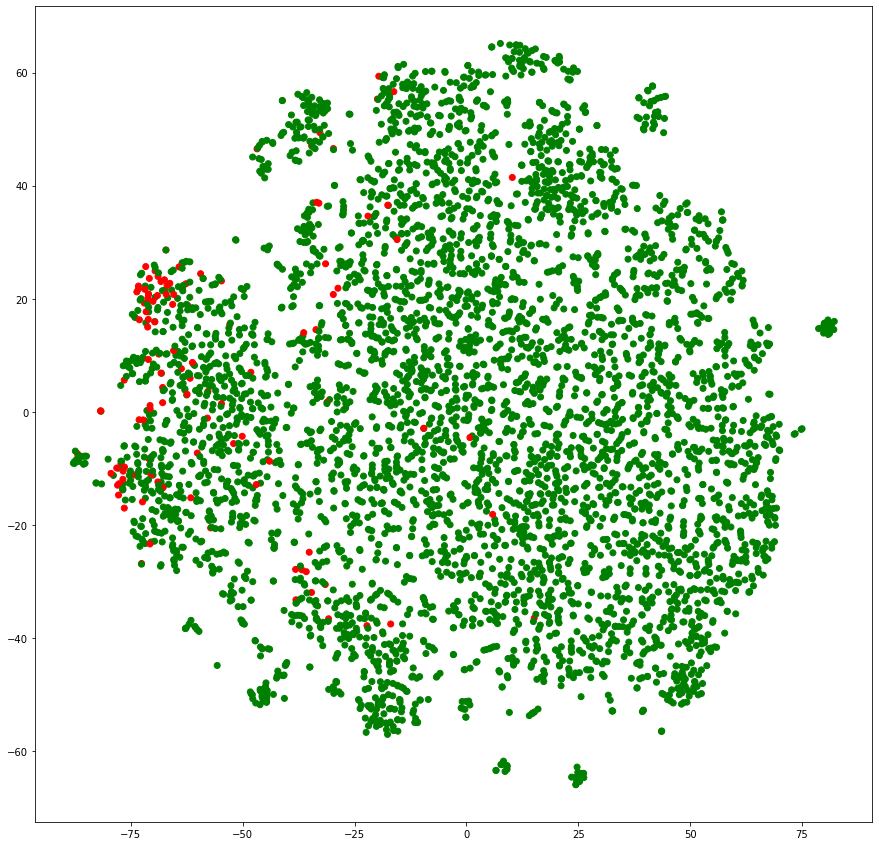

In [52]:
colours={0:'green',1:'red'}
plt.figure(figsize=(15,15))
plt.scatter(x_tsne[:,0],x_tsne[:,1],c=y.map(colours));

Inference: t-SNE is not a good reduction method since the clusters are not clearly formed.

## K-Means Clustering

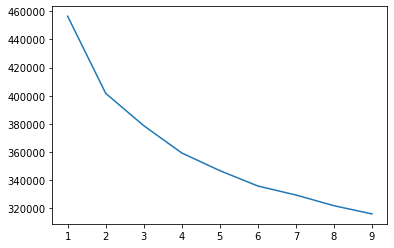

In [54]:
# Elbow method

from sklearn.cluster import KMeans
SSD=[]

for k in range(1,10):
    kmeans=KMeans(n_clusters=k, random_state=10)
    kmeans.fit(x_scaled)
    SSD.append(kmeans.inertia_)
plt.plot(range(1,10),SSD);

No. of clusters = 6

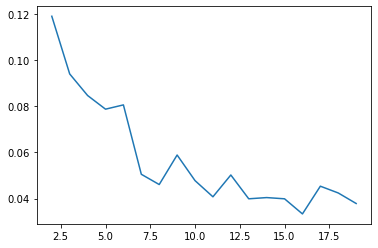

In [55]:
# Silhouette score

from sklearn.metrics import silhouette_score

SS=[]
for k in range(2,20):
    kmeans=KMeans(n_clusters=k, random_state=10)
    kmeans.fit(x_scaled)
    SS.append(silhouette_score(x_scaled,kmeans.predict(x_scaled)))
plt.plot(range(2,20),SS);

number of clusters = 2

In [56]:
# fitting and predicting

k_best=KMeans(n_clusters=2, random_state=10)
k_best.fit(x_scaled)
clusters=k_best.predict(x_scaled)
print(' The cluser labels are:\n', clusters)

 The cluser labels are:
 [1 1 1 ... 1 1 0]


In [57]:
k_best.cluster_centers_

array([[ 0.66255144,  0.65652906,  0.65442747,  0.49015815,  0.48820456,
         0.51418179,  0.37090003,  0.36484751,  0.16264118,  0.33544721,
        -0.05723728,  0.1201685 ,  0.48937614,  0.04942514,  0.23568293,
         0.49856573,  0.49844806,  0.49824364,  0.62731104,  0.42041199,
         0.05431162,  0.5521213 ,  0.62463398,  0.01595793,  0.06953141,
         0.14774856,  0.14831346,  0.09766941,  0.02295641,  0.15817355,
         0.23236121,  0.29260468,  0.4668039 ,  0.51128809, -0.08227564,
        -0.51866354, -0.5821749 ,  0.5821749 ,  0.07731226, -0.55424212,
        -0.11709472,  0.55211844,  0.62728288, -0.31211465,  0.11259346,
        -0.01427407,  0.02213129, -0.04106881, -0.11559227, -0.12940642,
        -0.05081995,  0.34869302, -0.16432126,  0.46893123,  0.27431817,
         0.1261322 ,  0.40603038,  0.49903498, -0.02369333, -0.44743176,
         0.50106038, -0.07646825, -0.01089202,  0.09732978,  0.29788226,
        -0.45587077,  0.03987972,  0.59650843,  0.4

Inference: In elbow method number of clusters=6 and in silhouette method number of clusters=2. But silhouette method is better since the plot is more promising.

## Hierarchical Clustering

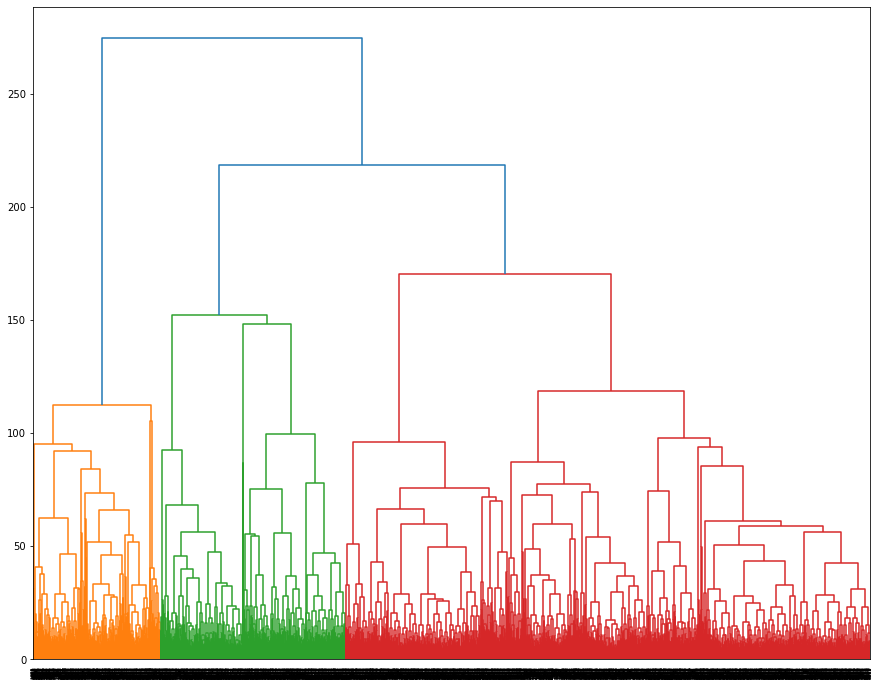

In [59]:
import scipy.cluster.hierarchy as sch
plt.figure(figsize=(15,12))
dendro=sch.dendrogram(sch.linkage(bank_2,method='ward'))

number of clusters = 3

## Agglomerative Clustering

In [61]:
from sklearn.cluster import AgglomerativeClustering
clust=AgglomerativeClustering(n_clusters=3,linkage='ward')
type(clust)

sklearn.cluster._agglomerative.AgglomerativeClustering

In [62]:
clust.fit_predict(x_scaled)

array([1, 0, 1, ..., 0, 0, 2], dtype=int64)

In [64]:
bank_2['label_HC']=pd.Series(clust.labels_)
bank_2

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Equity to Liability,label_HC
0,-2.852841,-2.809048,-3.182071,-0.586744,-0.586739,-0.364110,-1.497294,-1.692656,-1.576447,-1.653973,...,-3.386842,0.063657,-0.407346,-0.586964,-5.537901,2.778007,-0.224002,-0.513182,-0.999716,1
1,-0.874521,-0.468848,-0.708067,-0.854509,-0.855147,-0.337196,-0.252871,-0.204078,-0.118064,-0.201696,...,-0.550827,-0.151761,-0.137870,-0.854533,-0.418816,-0.336684,-1.118488,3.797442,-0.238661,0
2,-2.426946,-2.371659,-2.536580,1.265238,1.269690,-0.200249,-1.173068,-1.237889,-1.280771,-1.152330,...,-2.669453,0.432739,-0.081289,1.265304,-4.652608,3.391515,-0.213519,-0.457277,-1.031951,1
3,0.033443,0.197863,0.072659,-0.558597,-0.560694,-0.091800,-0.037918,-0.030012,0.004460,-0.018133,...,0.186906,0.095315,-0.002684,-0.558317,0.211062,-0.311764,-0.016013,0.246650,-0.262733,0
4,-0.382239,-0.331255,-0.262588,-0.370944,-0.370421,-0.421897,-0.129579,-0.100579,0.072955,-0.077998,...,-0.237680,-0.274896,0.053829,-0.370631,-0.201094,-0.893976,-0.083693,0.061413,0.975106,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4904,-0.316874,-0.241764,-0.377367,0.591134,0.588903,-0.163044,-0.071707,-0.083329,0.002333,-0.062130,...,-0.125386,-0.286030,-0.044543,0.591340,-0.120690,-0.857294,-0.122089,-0.065072,0.812143,2
4905,-0.611018,-0.618746,-0.627381,-1.150422,-1.148876,-0.805031,-0.228428,-0.233481,0.162296,-0.193041,...,-0.586661,-0.168009,-0.189493,-1.150406,-0.464970,0.412405,-2.300175,2.357150,-0.666268,0
4906,-0.273978,-0.447594,-0.263724,-0.286501,-0.285051,-0.207374,-0.141441,-0.121749,-0.055951,-0.104685,...,-0.372651,-0.289356,-0.096377,-0.286397,-0.255186,-0.045749,0.000317,0.285509,-0.462721,0
4907,-0.662084,-0.472204,-0.668292,-0.902144,-0.902896,-0.206582,-0.127422,-0.133118,-0.039359,-0.109013,...,-0.379130,-0.229119,0.034319,-0.902148,-0.277734,-0.438388,-0.026628,0.220286,-0.126892,0


In [65]:
bank_2['label_HC'].value_counts()

0    3077
2    1084
1     748
Name: label_HC, dtype: int64

In [67]:
bank_3=bank_2.iloc[:,0:21]
bank_3

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥)
0,-2.852841,-2.809048,-3.182071,-0.586744,-0.586739,-0.364110,-1.497294,-1.692656,-1.576447,-1.653973,...,-1.005632,-0.069696,-0.975010,-1.833738,-1.829837,-1.830371,-2.767053,-1.150016,-0.637251,-0.686922
1,-0.874521,-0.468848,-0.708067,-0.854509,-0.855147,-0.337196,-0.252871,-0.204078,-0.118064,-0.201696,...,-0.472637,-0.069696,-0.975010,-0.957571,-0.955456,-0.956622,-0.701653,-0.391191,-0.209114,-0.629244
2,-2.426946,-2.371659,-2.536580,1.265238,1.269690,-0.200249,-1.173068,-1.237889,-1.280771,-1.152330,...,-0.672510,-0.069696,-0.975010,-1.346559,-1.343651,-1.344536,-3.131535,-0.641747,-0.165873,-0.451402
3,0.033443,0.197863,0.072659,-0.558597,-0.560694,-0.091800,-0.037918,-0.030012,0.004460,-0.018133,...,0.022675,-0.069696,0.405950,-0.532705,-0.531457,-0.532929,-0.098683,0.109920,0.245181,-0.163009
4,-0.382239,-0.331255,-0.262588,-0.370944,-0.370421,-0.421897,-0.129579,-0.100579,0.072955,-0.077998,...,-0.426797,-0.069696,-0.923567,-0.209807,-0.209217,-0.210922,-0.422667,-0.430564,-0.318017,-0.730181
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4904,-0.316874,-0.241764,-0.377367,0.591134,0.588903,-0.163044,-0.071707,-0.083329,0.002333,-0.062130,...,-0.536348,-0.069696,1.634357,-0.872598,-0.870656,-0.871883,-0.409168,-0.505731,-0.408769,-0.480241
4905,-0.611018,-0.618746,-0.627381,-1.150422,-1.148876,-0.805031,-0.228428,-0.233481,0.162296,-0.193041,...,-0.328899,-0.069696,-0.975010,-0.368424,-0.367510,-0.369101,-0.665655,-0.108421,-0.400761,-1.100285
4906,-0.273978,-0.447594,-0.263724,-0.286501,-0.285051,-0.207374,-0.141441,-0.121749,-0.055951,-0.104685,...,-0.358230,-0.069696,0.018359,-0.619567,-0.618141,-0.619550,-0.508163,-0.208644,-0.524078,-0.552339
4907,-0.662084,-0.472204,-0.668292,-0.902144,-0.902896,-0.206582,-0.127422,-0.133118,-0.039359,-0.109013,...,-0.561599,-0.069696,2.280934,-0.338211,-0.337359,-0.338972,-0.503663,-0.480675,-0.443468,-0.528306


In [68]:
bank_3['label_HC']=pd.Series(clust.labels_)
bank_3

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),label_HC
0,-2.852841,-2.809048,-3.182071,-0.586744,-0.586739,-0.364110,-1.497294,-1.692656,-1.576447,-1.653973,...,-0.069696,-0.975010,-1.833738,-1.829837,-1.830371,-2.767053,-1.150016,-0.637251,-0.686922,1
1,-0.874521,-0.468848,-0.708067,-0.854509,-0.855147,-0.337196,-0.252871,-0.204078,-0.118064,-0.201696,...,-0.069696,-0.975010,-0.957571,-0.955456,-0.956622,-0.701653,-0.391191,-0.209114,-0.629244,0
2,-2.426946,-2.371659,-2.536580,1.265238,1.269690,-0.200249,-1.173068,-1.237889,-1.280771,-1.152330,...,-0.069696,-0.975010,-1.346559,-1.343651,-1.344536,-3.131535,-0.641747,-0.165873,-0.451402,1
3,0.033443,0.197863,0.072659,-0.558597,-0.560694,-0.091800,-0.037918,-0.030012,0.004460,-0.018133,...,-0.069696,0.405950,-0.532705,-0.531457,-0.532929,-0.098683,0.109920,0.245181,-0.163009,0
4,-0.382239,-0.331255,-0.262588,-0.370944,-0.370421,-0.421897,-0.129579,-0.100579,0.072955,-0.077998,...,-0.069696,-0.923567,-0.209807,-0.209217,-0.210922,-0.422667,-0.430564,-0.318017,-0.730181,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4904,-0.316874,-0.241764,-0.377367,0.591134,0.588903,-0.163044,-0.071707,-0.083329,0.002333,-0.062130,...,-0.069696,1.634357,-0.872598,-0.870656,-0.871883,-0.409168,-0.505731,-0.408769,-0.480241,2
4905,-0.611018,-0.618746,-0.627381,-1.150422,-1.148876,-0.805031,-0.228428,-0.233481,0.162296,-0.193041,...,-0.069696,-0.975010,-0.368424,-0.367510,-0.369101,-0.665655,-0.108421,-0.400761,-1.100285,0
4906,-0.273978,-0.447594,-0.263724,-0.286501,-0.285051,-0.207374,-0.141441,-0.121749,-0.055951,-0.104685,...,-0.069696,0.018359,-0.619567,-0.618141,-0.619550,-0.508163,-0.208644,-0.524078,-0.552339,0
4907,-0.662084,-0.472204,-0.668292,-0.902144,-0.902896,-0.206582,-0.127422,-0.133118,-0.039359,-0.109013,...,-0.069696,2.280934,-0.338211,-0.337359,-0.338972,-0.503663,-0.480675,-0.443468,-0.528306,0


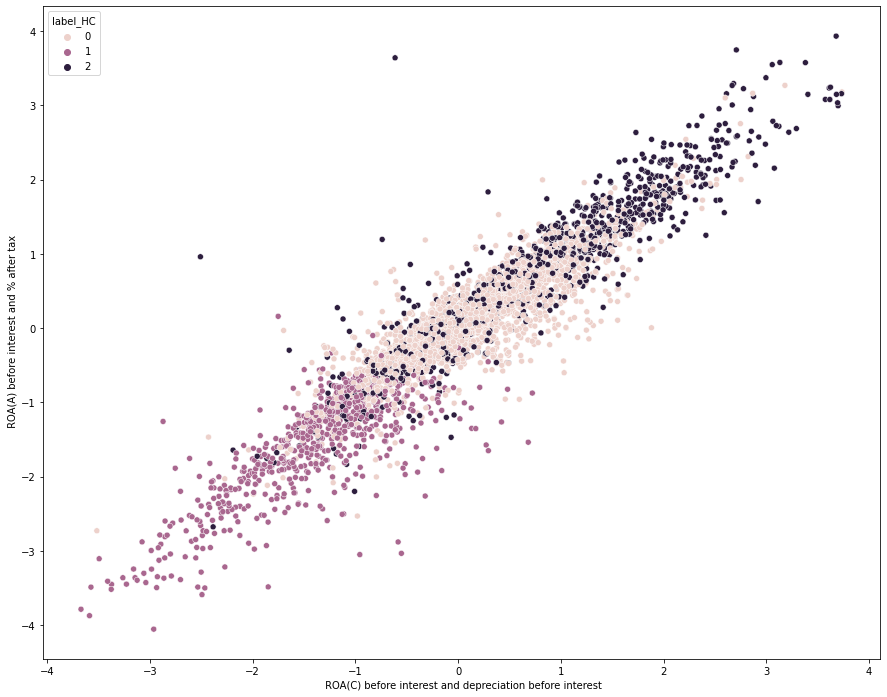

In [70]:
plt.figure(figsize=(15,12))

sns.scatterplot(x=bank_3[' ROA(C) before interest and depreciation before interest'],y=bank_3[' ROA(A) before interest and % after tax'],hue=bank_3['label_HC']);

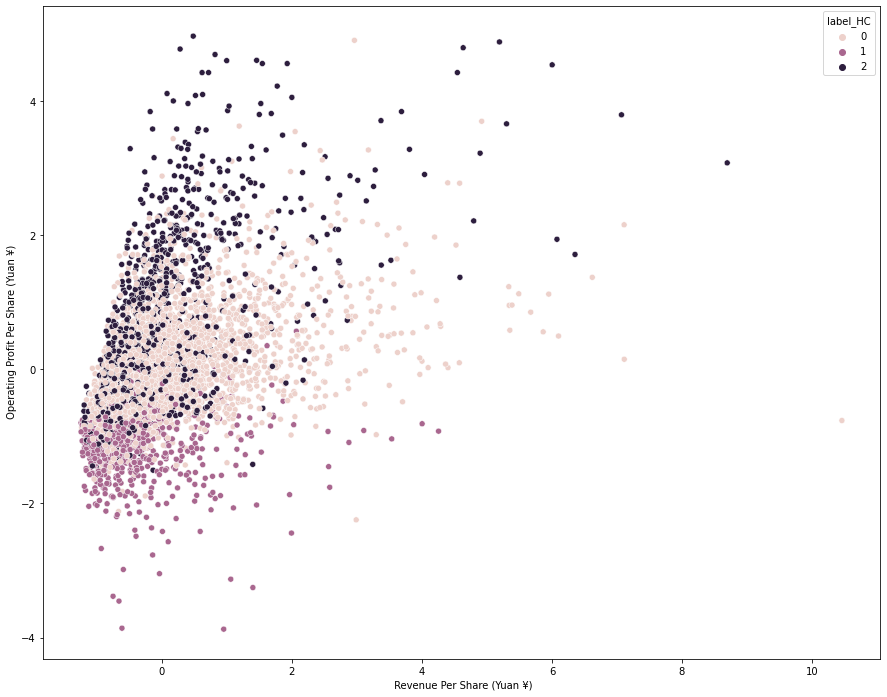

In [71]:
plt.figure(figsize=(15,12))

sns.scatterplot(x=bank_3[' Revenue Per Share (Yuan ¥)'],y=bank_3[' Operating Profit Per Share (Yuan ¥)'],hue=bank_3['label_HC']);

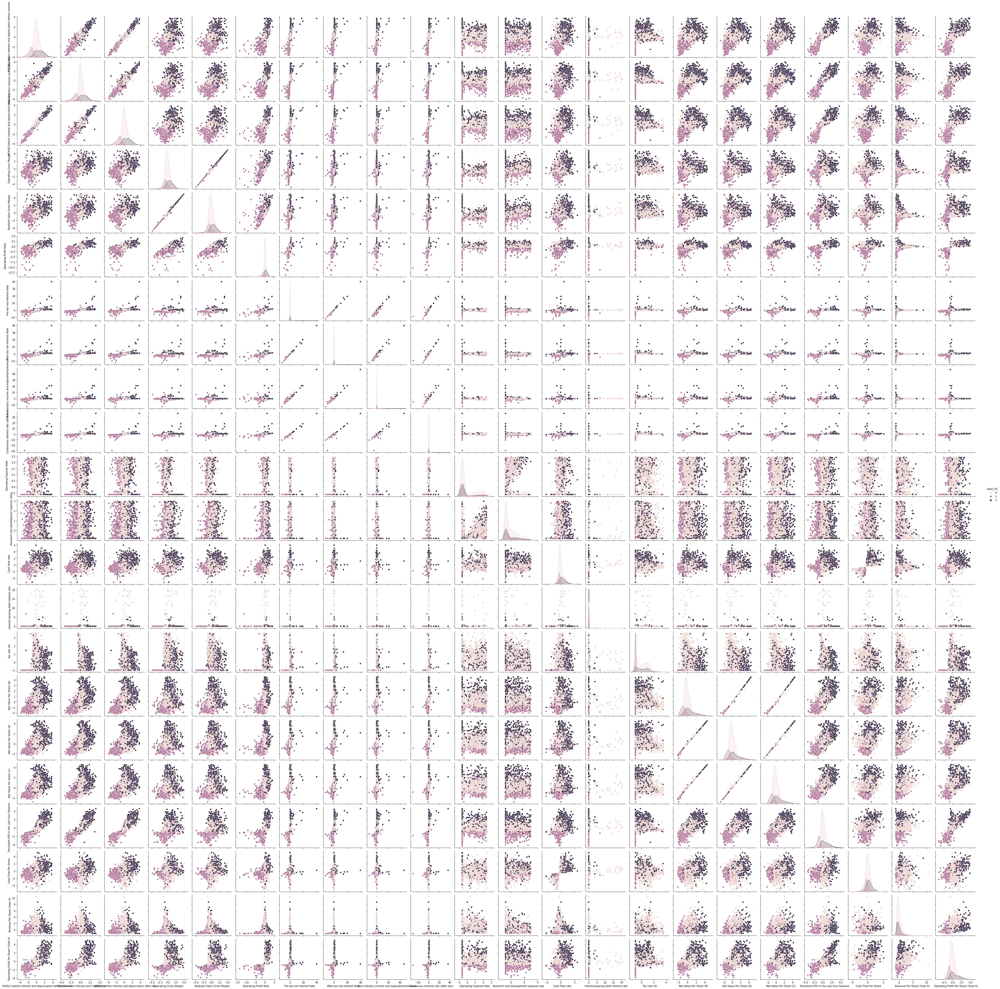

In [72]:
sns.pairplot(bank_3,hue='label_HC');

Inference:Here, number of clusters=3. HC is the best clustering since most of the clusters are clearly visible.

## GMM

In [73]:
from sklearn.mixture import GaussianMixture
n_components=np.arange(1,7,1)
aic_score=[]
bic_score=[]

for n in n_components:
    model=GaussianMixture(n_components=n,random_state=100,n_init=5)
    model.fit(x_scaled)
    aic_score.append(model.aic(x_scaled))
    bic_score.append(model.bic(x_scaled))

In [74]:
print(aic_score)

[143964.2928620144, -277182.932156762, -508898.33355202083, -670431.8147885278, -670135.1520238498, -690258.3357448187]


In [75]:
print(bic_score)

[172975.05004604955, -219154.91896315763, -421853.06434884726, -554369.289575785, -525055.3708015378, -516161.2985129375]


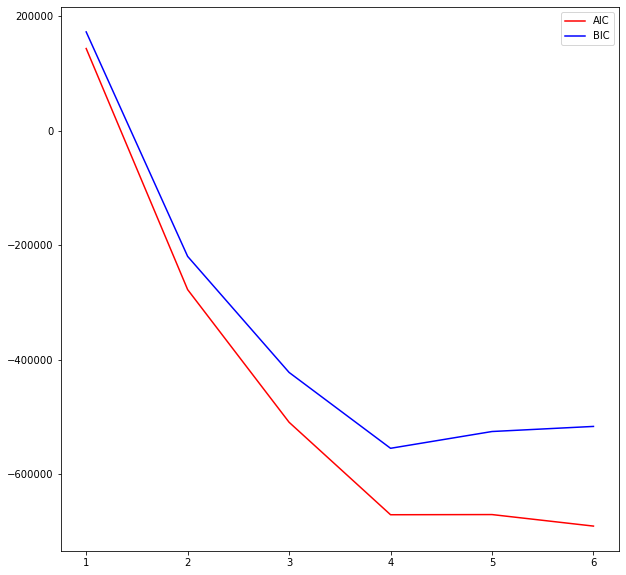

In [76]:
# Plotting
plt.figure(figsize=(10,10))
plt.plot(n_components,aic_score,c='r',label='AIC')
plt.plot(n_components,bic_score,c='b',label='BIC')
plt.legend();

## Building a Gaussian model with k=4

In [79]:
gm=GaussianMixture(n_components=4,random_state=100,n_init=5)
gm.fit(x_scaled)

GaussianMixture(n_components=4, n_init=5, random_state=100)

In [80]:
pred=gm.predict(x_scaled)

In [81]:
pred

array([3, 3, 2, ..., 1, 1, 0], dtype=int64)

In [83]:
gm.means_

array([[ 4.06859234e-01,  4.65707664e-01,  4.10529050e-01,
         4.61927739e-01,  4.60998455e-01,  2.73324987e-01,
         6.03985843e-01,  5.93299279e-01,  5.67964393e-01,
         5.29420897e-01, -1.41696920e-01, -8.39520895e-02,
         4.25905566e-01,  8.98346399e-01, -4.02308102e-02,
         3.46276037e-01,  3.45732490e-01,  3.53333304e-01,
         3.36183558e-01,  2.90820168e-02, -3.93916197e-01,
         8.02572729e-02,  4.03546610e-01,  1.97162755e-01,
         4.14626165e-02,  1.13296101e-01,  1.15283252e-01,
         1.48470634e-01, -3.08754308e-01,  5.21742942e-01,
         4.95032505e-01, -3.58816713e-02,  1.40439363e+00,
         1.44456877e+00, -1.24374390e-01, -8.31122002e-01,
        -1.15950732e+00,  1.15950732e+00,  3.00390606e-01,
        -7.62094164e-01, -4.01381561e-02,  6.85899841e-02,
         3.36821373e-01, -6.50703560e-01, -2.31369248e-01,
        -1.42740660e-02,  2.73192805e-01, -1.41621197e-01,
        -1.43544085e-01, -4.74519676e-01, -1.42204866e-0

In [84]:
gm.covariances_

array([[[ 1.55184207e+00,  1.37431664e+00,  1.50896557e+00, ...,
          1.95919242e-03,  8.01831656e-03, -7.15247427e-01],
        [ 1.37431664e+00,  1.44365161e+00,  1.37079351e+00, ...,
          1.88138505e-03,  7.83435664e-03, -6.60125636e-01],
        [ 1.50896557e+00,  1.37079351e+00,  1.52493869e+00, ...,
          2.22002721e-03,  8.86480974e-03, -6.98057494e-01],
        ...,
        [ 1.95919242e-03,  1.88138505e-03,  2.22002721e-03, ...,
          3.78421855e-04,  1.24791935e-03, -6.93178644e-03],
        [ 8.01831656e-03,  7.83435664e-03,  8.86480974e-03, ...,
          1.24791935e-03,  4.15400217e-03, -2.35037339e-02],
        [-7.15247427e-01, -6.60125636e-01, -6.98057494e-01, ...,
         -6.93178644e-03, -2.35037339e-02,  2.76658124e+00]],

       [[ 7.53717026e-01,  6.81637961e-01,  7.23597126e-01, ...,
         -1.61805812e-02, -2.97993098e-02,  1.62671819e-01],
        [ 6.81637961e-01,  6.75136778e-01,  6.71906785e-01, ...,
         -1.42437380e-02, -2.50157082e

In [85]:
gm.weights_

array([0.06840506, 0.54998631, 0.06558466, 0.31602396])

In [87]:
bank_4=bank_2.iloc[:,0:21]
bank_4['label_GMM']=pd.Series(pred)
bank_4

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),...,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),label_GMM
0,-2.852841,-2.809048,-3.182071,-0.586744,-0.586739,-0.364110,-1.497294,-1.692656,-1.576447,-1.653973,...,-1.005632,-0.069696,-0.975010,-1.833738,-1.829837,-1.830371,-2.767053,-1.150016,-0.637251,3
1,-0.874521,-0.468848,-0.708067,-0.854509,-0.855147,-0.337196,-0.252871,-0.204078,-0.118064,-0.201696,...,-0.472637,-0.069696,-0.975010,-0.957571,-0.955456,-0.956622,-0.701653,-0.391191,-0.209114,3
2,-2.426946,-2.371659,-2.536580,1.265238,1.269690,-0.200249,-1.173068,-1.237889,-1.280771,-1.152330,...,-0.672510,-0.069696,-0.975010,-1.346559,-1.343651,-1.344536,-3.131535,-0.641747,-0.165873,2
3,0.033443,0.197863,0.072659,-0.558597,-0.560694,-0.091800,-0.037918,-0.030012,0.004460,-0.018133,...,0.022675,-0.069696,0.405950,-0.532705,-0.531457,-0.532929,-0.098683,0.109920,0.245181,1
4,-0.382239,-0.331255,-0.262588,-0.370944,-0.370421,-0.421897,-0.129579,-0.100579,0.072955,-0.077998,...,-0.426797,-0.069696,-0.923567,-0.209807,-0.209217,-0.210922,-0.422667,-0.430564,-0.318017,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4904,-0.316874,-0.241764,-0.377367,0.591134,0.588903,-0.163044,-0.071707,-0.083329,0.002333,-0.062130,...,-0.536348,-0.069696,1.634357,-0.872598,-0.870656,-0.871883,-0.409168,-0.505731,-0.408769,0
4905,-0.611018,-0.618746,-0.627381,-1.150422,-1.148876,-0.805031,-0.228428,-0.233481,0.162296,-0.193041,...,-0.328899,-0.069696,-0.975010,-0.368424,-0.367510,-0.369101,-0.665655,-0.108421,-0.400761,3
4906,-0.273978,-0.447594,-0.263724,-0.286501,-0.285051,-0.207374,-0.141441,-0.121749,-0.055951,-0.104685,...,-0.358230,-0.069696,0.018359,-0.619567,-0.618141,-0.619550,-0.508163,-0.208644,-0.524078,1
4907,-0.662084,-0.472204,-0.668292,-0.902144,-0.902896,-0.206582,-0.127422,-0.133118,-0.039359,-0.109013,...,-0.561599,-0.069696,2.280934,-0.338211,-0.337359,-0.338972,-0.503663,-0.480675,-0.443468,1


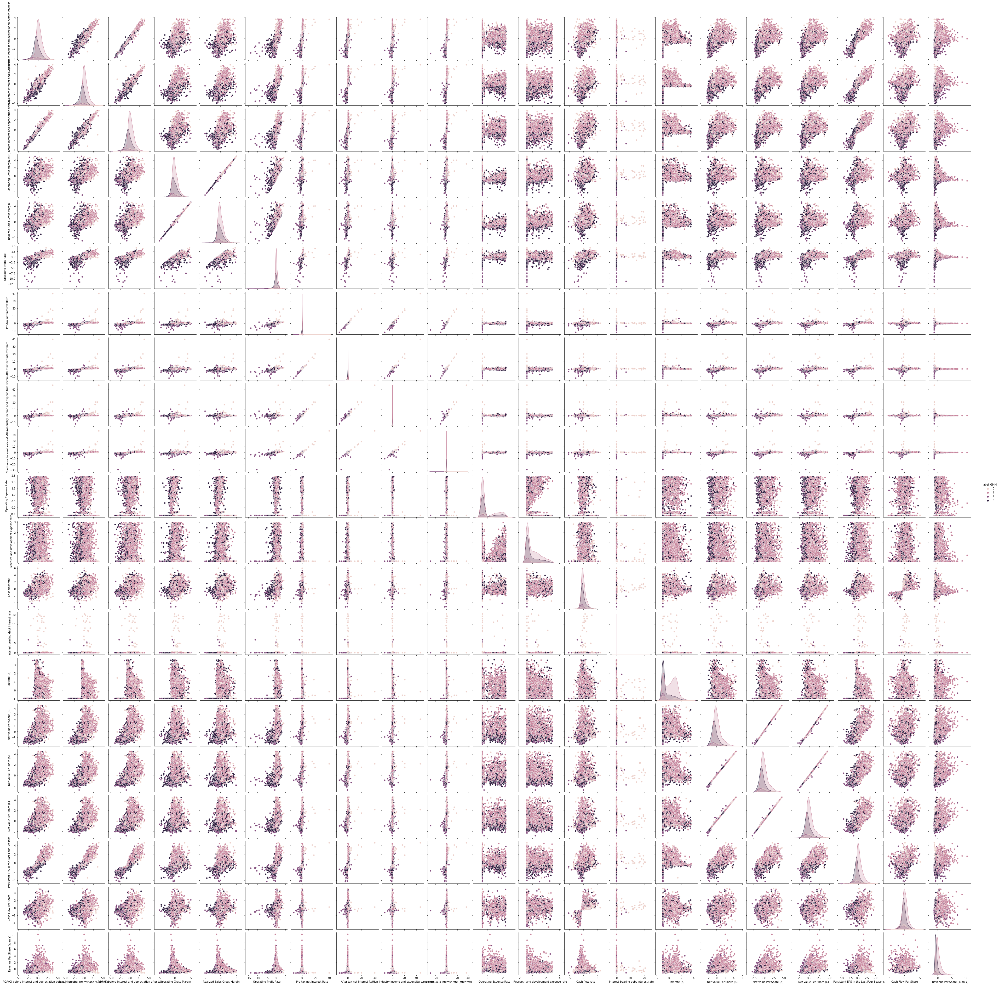

In [88]:
sns.pairplot(bank_4,hue='label_GMM');

Inference: Through AIC and BIC score we got number of clusters to be 4. But in pair plot evidently, clusters are not clearly visible. Thus, GMM clustering is not that effective.

Thank you 